In [1]:
import sctt as st
import scanpy as sc
import anndata
import scvelo as scv

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/pyemma/__init__.py:92: UserWarning: You are not using the latest release of PyEMMA. Latest is 2.5.7, you have 2.5.6.
  .format(latest=latest, current=current), category=UserWarning)


In [2]:
data_dir = '../data/emt_sim/'
adata = sc.read_h5ad(data_dir+'emt_circuit_larger_noise.h5ad')

In [3]:
adata

AnnData object with n_obs × n_vars = 5000 × 9
    obs: 'tgf', 'leiden'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'umap'
    obsm: 'X_umap'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

scVelo results

In [4]:
#scv.pp.moments(adata)
scv.tl.velocity(adata, mode = 'dynamical')
scv.tl.velocity_graph(adata)

computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph (using 1/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


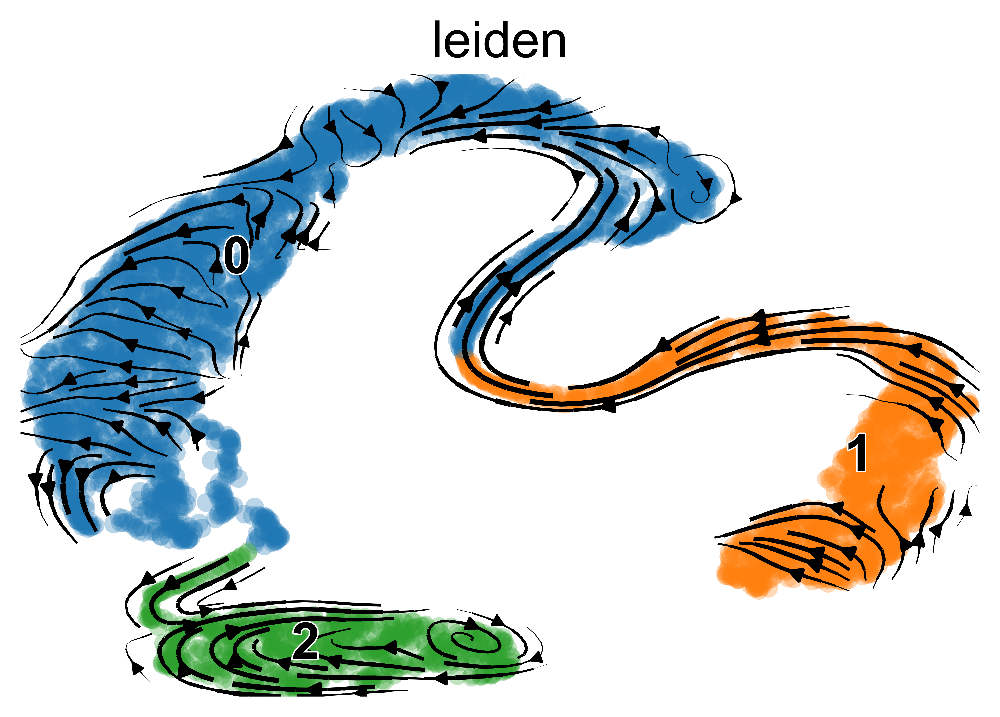

In [5]:
scv.set_figure_params(dpi =600,fontsize = 18)
scv.pl.velocity_embedding_stream(adata, basis='umap', color=['leiden'])

multi-stable attractors

In [6]:
adata.obs['attractor'] = adata.obs['leiden'].values
adata_aggr = st.dynamical_iteration(adata,n_states =3, n_iter = 15, return_aggr_obj=True, weight_connectivities = 0.5,n_components = 22, n_neighbors = 50,thresh_ms_gene = 0.2)

  0%|          | 0/5000 [00:00<?, ?cell/s]

  0%|          | 0/5000 [00:00<?, ?cell/s]

0.5558963358032267


  0%|          | 0/5000 [00:00<?, ?cell/s]

  0%|          | 0/5000 [00:00<?, ?cell/s]

Trying to set attribute `.obs` of view, copying.


0.06966943479292992


In [7]:
sc.pp.neighbors(adata_aggr)
sc.tl.umap(adata_aggr)

In [8]:
adata_aggr.obs['tgf']=adata.obs['tgf'].values
sc.pl.umap(adata_aggr,color = ['speed','entropy','E','N','tgf'])

or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 1/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


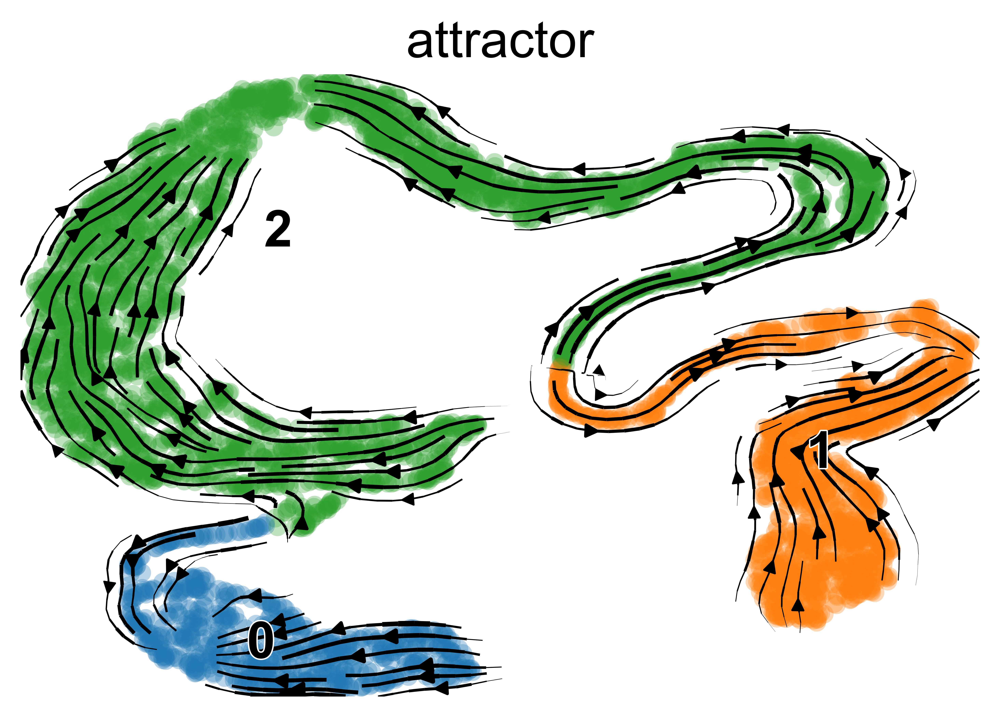

In [9]:
scv.tl.velocity_graph(adata_aggr)
scv.pl.velocity_embedding_stream(adata_aggr, basis='umap', color='attractor')

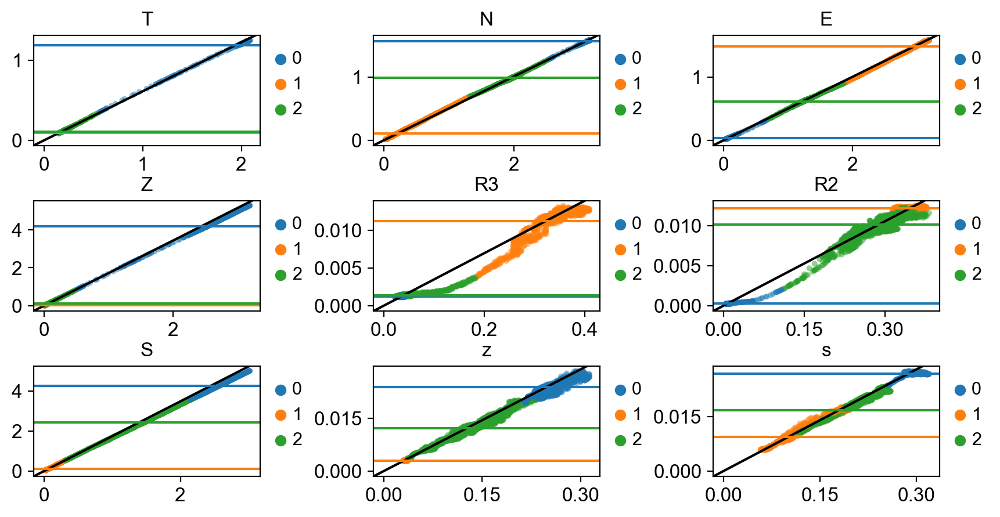

In [10]:
scv.set_figure_params(fontsize = 12)
st.plot_top_genes(adata, ncols=3,figsize = (10,5),wspace = 0.5, top_genes=9)

In [11]:
sc.set_figure_params(dpi=600,fontsize = 10)
import matplotlib as mpl
mpl.rcParams['axes.grid'] = False
adata.obsm['X_umap_aggr']=adata_aggr.obsm['X_umap']
st.plot_tensor(adata, adata_aggr, basis = 'umap')

check that the input includes aggregated object
or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
check that the input includes aggregated object
or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:01) --> added 
    'vj_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vj_umap', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:05) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:08) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:07) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:05) --> added 
    'vs_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vs_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:06) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:06) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:08) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)
computing velocity graph (using 8/8 cores)


  0%|          | 0/5000 [00:00<?, ?cells/s]

/Users/cliffzhou/opt/anaconda3/lib/python3.7/site-packages/scvelo/core/_parallelize.py:138: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  res = np.array(res) if as_array else res


    finished (0:00:08) --> added 
    'vu_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'vu_umap_aggr', embedded velocity vectors (adata.obsm)


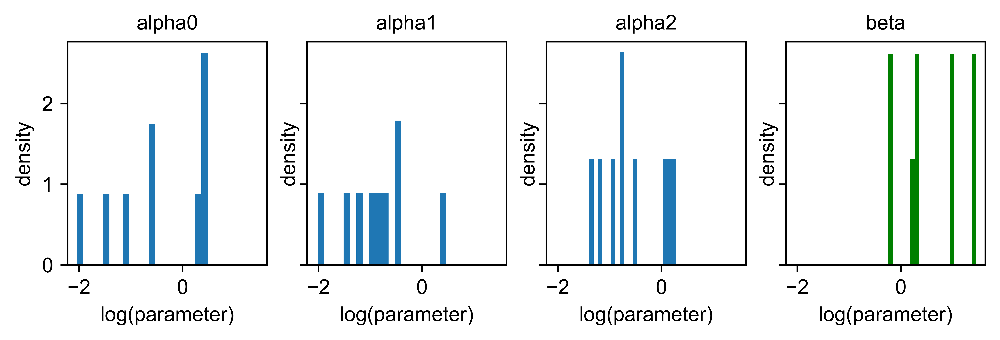

In [12]:
st.plot_para_hist(adata,figsize=(8,2))